In [1]:
import geopandas as gpd
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import griddata
from matplotlib import cm

import datashader as ds
import plotly.express as px
import plotly.graph_objects as go

from PIL import Image, ImageOps

import pickle

In [2]:
### functions to calculate the data point to raster images

def get_max_res(bounds):
    return max((bounds[1] - bounds[0]) / 5000, 0.0002)

def get_space_coords(x_bounds, y_bounds):
    xres_max = get_max_res(x_bounds)
    yres_max = get_max_res(y_bounds)
    return np.arange(y_bounds[0], y_bounds[1], yres_max), np.arange(x_bounds[0], x_bounds[1], xres_max)

def interpolate_2d(geometry, feature, x_bounds=None, y_bounds=None):
    if not x_bounds or not y_bounds:
        raise Exception("Must provide x_bounds and y_bounds")
    
    gy, gx = np.meshgrid(*get_space_coords(x_bounds, y_bounds) )
    return griddata(geometry, feature/(feature.max()-feature.min()) , (gx, gy), method="cubic")

### Load data 

In [3]:
### Load data for raster image - skip for reading directly
# x_bounds=(-124.40117, -114.00217)
# y_bounds=(32.28567, 42.11017)

# gdf = gpd.read_file("../../../ca_nvda_grav.geojson")

# coord_list = list(zip(gdf.geometry.x, gdf.geometry.y))

# grid_1 = interpolate_2d(coord_list, gdf["isostatic_anom"].values,
#                         x_bounds=x_bounds, y_bounds=y_bounds)

# df_ca = pd.read_csv('ca_state_border.csv')

# cvs_ca = ds.Canvas(plot_width=4939, plot_height=4826)
# agg_ca = cvs_ca.points(df_ca, x='longitude', y='latitude')

# coords_lat_ca, coords_lon_ca = agg_ca.coords['latitude'].values, agg_ca.coords['longitude'].values
# coordinates_ca = [[coords_lon2_ca[0], coords_lat_ca[0]],
#                [coords_lon_ca[-1], coords_lat_ca[0]],
#                [coords_lon_ca[-1], coords_lat_ca[-1]],
#                [coords_lon_ca[0], coords_lat_ca[-1]]]

# df_nv = pd.read_csv('nv_state_border.csv')

# cvs_nv = ds.Canvas(plot_width=2870, plot_height=3564)
# agg_nv = cvs_nv.points(df_nv, x='longitude', y='latitude')

# coords_lat_nv, coords_lon_nv = agg_nv.coords['latitude'].values, agg_nv.coords['longitude'].values
# coordinates_nv = [[coords_lon_nv[0], coords_lat_nv[0]],
#                [coords_lon_nv[-1], coords_lat_nv[0]],
#                [coords_lon_nv[-1], coords_lat_nv[-1]],
#                [coords_lon_nv[0], coords_lat_nv[-1]]]

coordinates_nv = []
coordinates_ca = []
with open("coordinates_nv", "rb") as fp:
  coordinates_nv = pickle.load(fp)

with open("coordinates_ca", "rb") as fp:
  coordinates_ca = pickle.load(fp)

### Read raster images from files

In [5]:
# read both rasters
raster_ca = Image.open(r"[1127]california_raster_final_3857_201119_full.png")
raster_nv = Image.open(r"[1127]nevada_raster_final_3857_201119_full.png")

# you can check the size of the image
# raster_nv.size

In [6]:
# Created a point at San Francisco just to pass to the scatter_mapbox later 
# for drawing the map

sf = pd.DataFrame()
sf['latitude'] = [37.7739]
sf['longitude'] = [-122.4312]

### Draw map


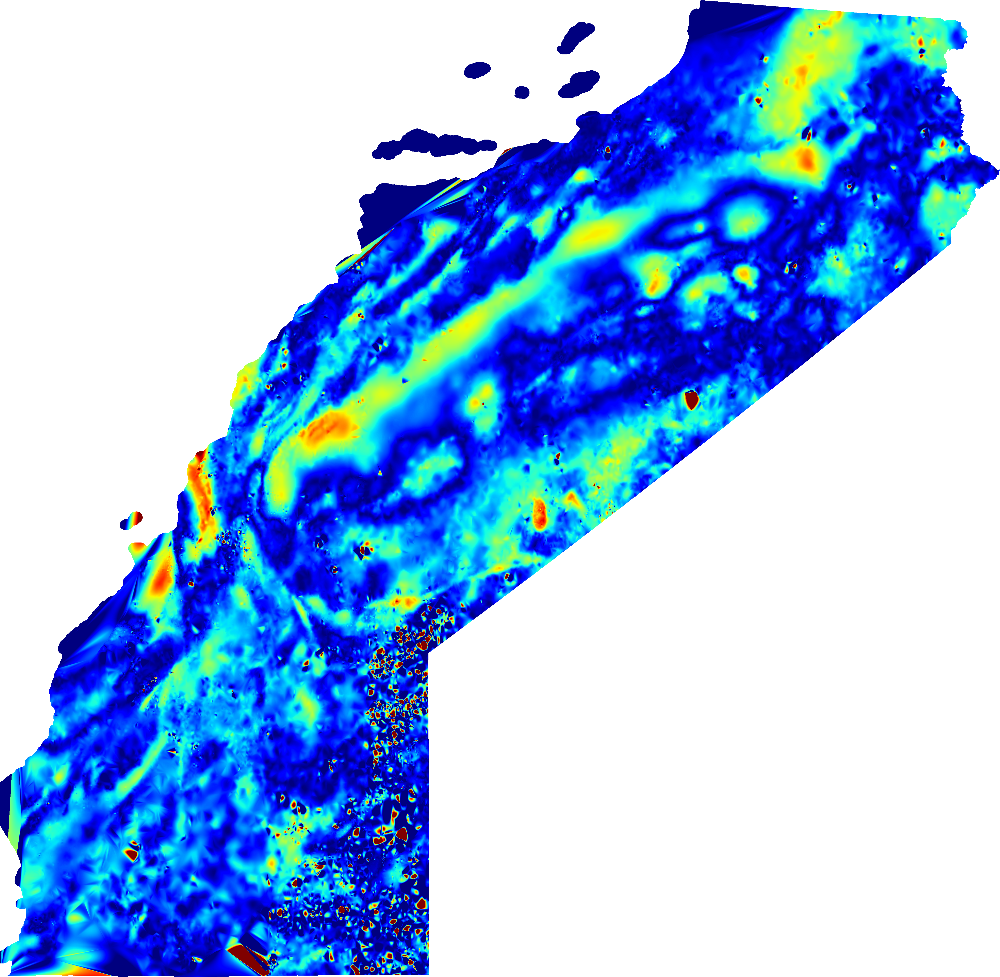
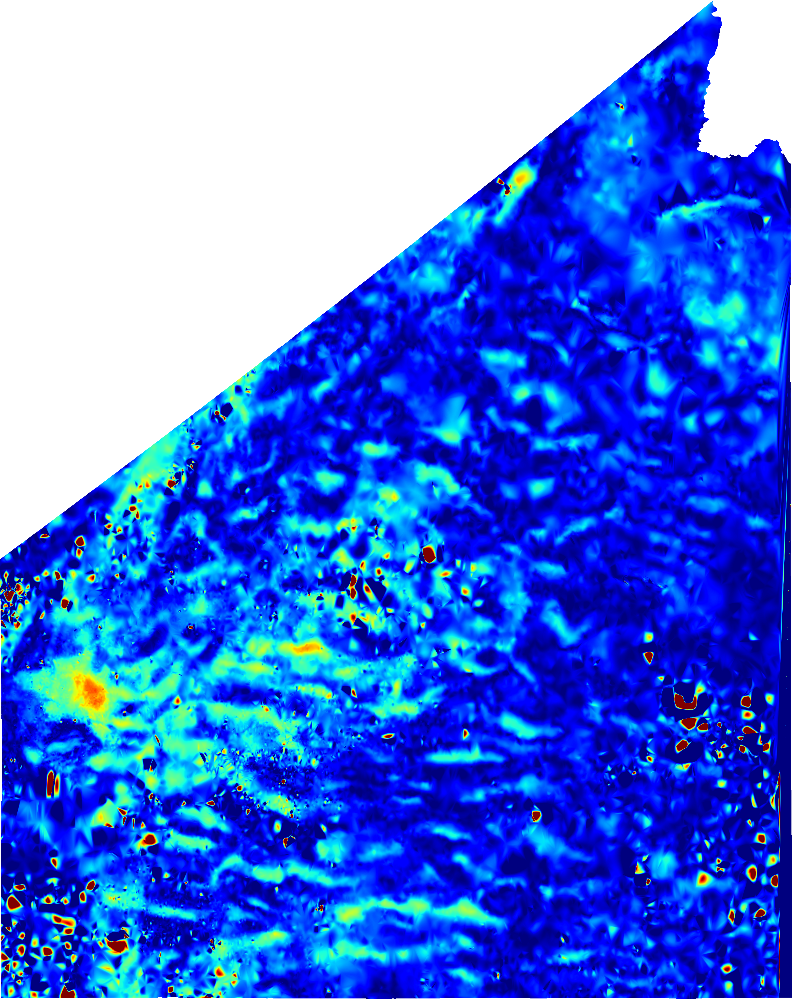

In [7]:
fig = px.scatter_mapbox(sf, lat='latitude', lon='longitude', zoom=4, opacity=1)
fig.update_layout(
                 mapbox_style="carto-darkmatter",
                 mapbox_layers = [
                {
                    "sourcetype": "image",
                    "source": raster_ca,
                    "coordinates": 
[[-124.35512655000002, 32.52981898580614],
 [-114.13227033846026, 32.52981898580614],#DR
 [-114.08227033846026, 42.00852602023825],#UR
 [-124.43096899740878, 42.00852602023825]],
                    'opacity': 0.5
                },
                {
                    "sourcetype": "image",
                    "source": raster_nv,
                    "coordinates": coordinates_nv,
                    'opacity': 0.5
                },
                {
                    "sourcetype": "vector",
                    "sourcelayer": "County",
                    "type": "line",
                    "opacity": 0.1,
                    "color": "white",
                    "source": [
                        "https://gis-server.data.census.gov/arcgis/rest/services/Hosted/VT_2019_050_00_PY_D1/VectorTileServer/tile/{z}/{y}/{x}.pbf"
                    ]
                }]
)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# Utilities

In [53]:
### Write coordinates to files with pickle

# with open("coordinates_nv", "wb") as fp:
#   pickle.dump(coordinates_nv, fp)

with open("coordinates_ca", "wb") as fp:
  pickle.dump(coordinates_ca, fp)

In [52]:
coordinates_ca = [[-124.35512655000002, 32.52981898580614],
 [-114.13227033846026, 32.52981898580614],#DR
 [-114.08227033846026, 42.00852602023825],#UR
 [-124.43096899740878, 42.00852602023825]]